## Rstanをやってみた

[RStan Getting Started (Japanese)](https://github.com/stan-dev/rstan/wiki/RStan-Getting-Started-(Japanese))

のコードを基本的にはなぞっただけ。

保存しなくていいようにweb上からモデルを直接とってきたよ

In [1]:
require(rstan)
require(RCurl)

# stanフィアルをmodelにいれとく

model <- getURL("https://raw.githubusercontent.com/wiki/stan-dev/rstan/8schools.stan")
cat(model)


Loading required package: rstan
Loading required package: ggplot2
Loading required package: StanHeaders
rstan (Version 2.10.1, packaged: 2016-06-24 13:22:16 UTC, GitRev: 85f7a56811da)
For execution on a local, multicore CPU with excess RAM we recommend calling
rstan_options(auto_write = TRUE)
options(mc.cores = parallel::detectCores())
Loading required package: RCurl
Loading required package: bitops


data {
  int<lower=0> J; // number of schools 
  real y[J]; // estimated treatment effects
  real<lower=0> sigma[J]; // s.e. of effect estimates 
}
parameters {
  real mu; 
  real<lower=0> tau;
  real eta[J];
}
transformed parameters {
  real theta[J];
  for (j in 1:J)
    theta[j] <- mu + tau * eta[j];
}
model {
  eta ~ normal(0, 1);
  y ~ normal(theta, sigma);
}


In [2]:
schools_dat <- list(J = 8,
                    y = c(28,  8, -3,  7, -1,  1, 18, 12),
                    sigma = c(15, 10, 16, 11,  9, 11, 10, 18))

fit <- stan(model_code = model, data = schools_dat,
            iter = 1000, chains = 4)


SAMPLING FOR MODEL '11c3f2ab2915ebbd699e7fb4bf5bd2dc' NOW (CHAIN 1).

Chain 1, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 1, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 1, Iteration: 200 / 1000 [ 20%]  (Warmup)
Chain 1, Iteration: 300 / 1000 [ 30%]  (Warmup)
Chain 1, Iteration: 400 / 1000 [ 40%]  (Warmup)
Chain 1, Iteration: 500 / 1000 [ 50%]  (Warmup)
Chain 1, Iteration: 501 / 1000 [ 50%]  (Sampling)
Chain 1, Iteration: 600 / 1000 [ 60%]  (Sampling)
Chain 1, Iteration: 700 / 1000 [ 70%]  (Sampling)
Chain 1, Iteration: 800 / 1000 [ 80%]  (Sampling)
Chain 1, Iteration: 900 / 1000 [ 90%]  (Sampling)
Chain 1, Iteration: 1000 / 1000 [100%]  (Sampling)
 Elapsed Time: 0.016095 seconds (Warm-up)
               0.012622 seconds (Sampling)
               0.028717 seconds (Total)


SAMPLING FOR MODEL '11c3f2ab2915ebbd699e7fb4bf5bd2dc' NOW (CHAIN 2).

Chain 2, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 2, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 2, Iteration: 200 / 1000 [ 20%]  (Warmup)

Inference for Stan model: 11c3f2ab2915ebbd699e7fb4bf5bd2dc.
4 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=2000.

          mean se_mean   sd   2.5%   25%   50%   75% 97.5% n_eff Rhat
mu        7.90    0.18 5.06  -2.28  4.74  7.80 11.01 18.48   781    1
tau       6.26    0.19 5.15   0.27  2.33  5.04  8.86 19.53   750    1
eta[1]    0.37    0.02 0.95  -1.53 -0.28  0.40  1.02  2.19  1614    1
eta[2]   -0.04    0.03 0.92  -1.96 -0.65 -0.08  0.55  1.89  1281    1
eta[3]   -0.19    0.02 0.91  -1.97 -0.80 -0.20  0.40  1.66  1571    1
eta[4]    0.00    0.02 0.88  -1.75 -0.58  0.00  0.59  1.73  2000    1
eta[5]   -0.32    0.02 0.87  -1.97 -0.90 -0.34  0.25  1.43  1261    1
eta[6]   -0.19    0.02 0.88  -1.93 -0.81 -0.22  0.39  1.56  1420    1
eta[7]    0.34    0.02 0.91  -1.51 -0.27  0.40  0.99  2.10  1465    1
eta[8]    0.09    0.02 0.92  -1.73 -0.51  0.07  0.69  1.83  1767    1
theta[1] 11.19    0.24 8.26  -2.39  5.93 10.01 15.02 3

'pars' not specified. Showing first 10 parameters by default.
ci_level: 0.8 (80% intervals)
outer_level: 0.95 (95% intervals)


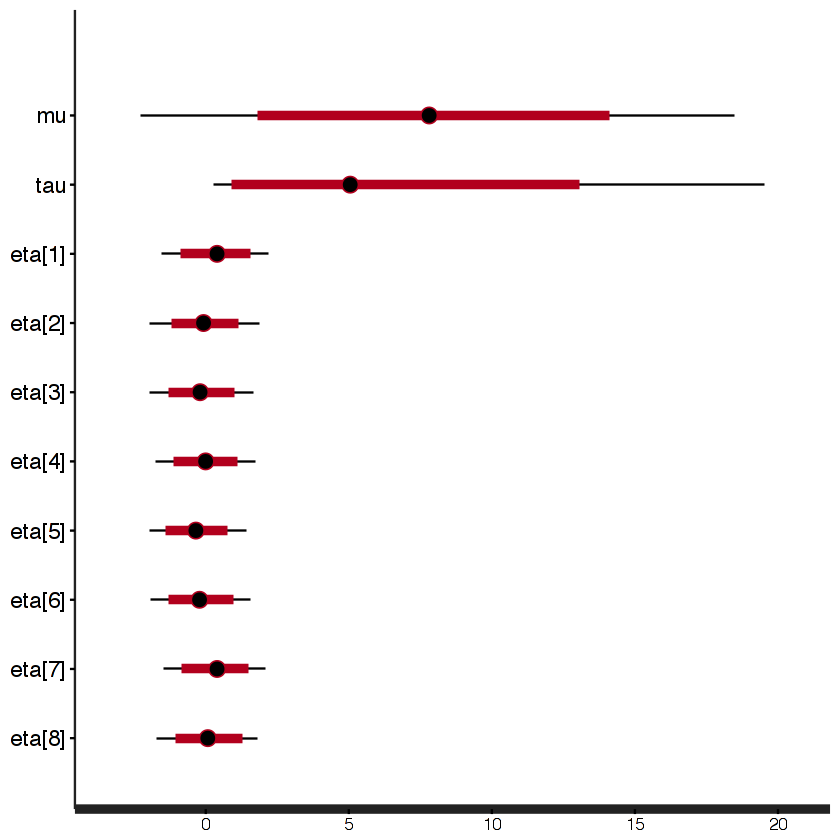

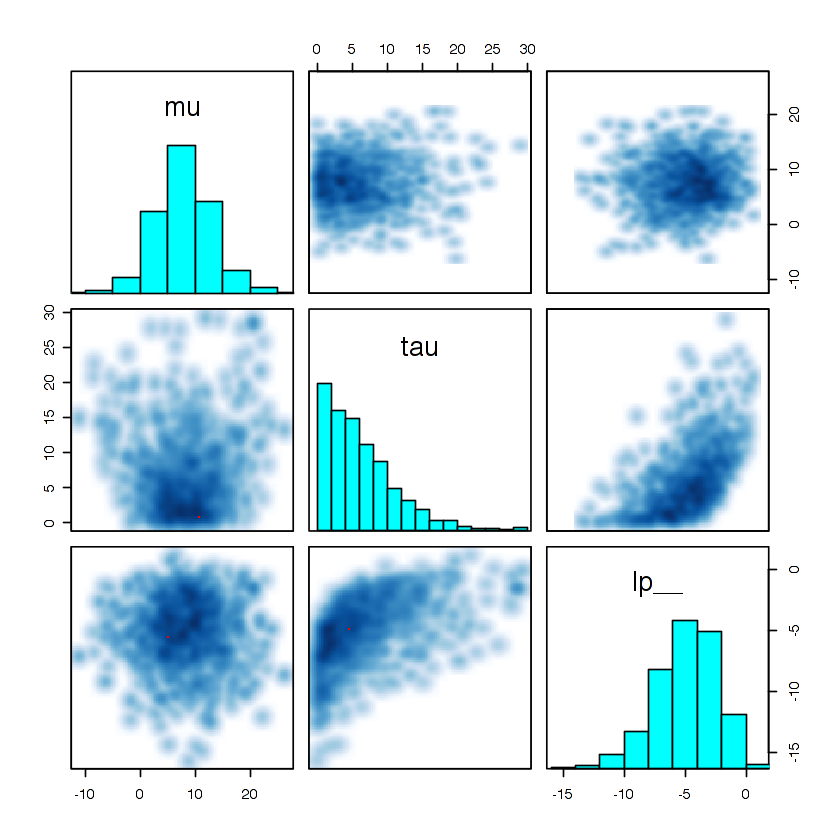

In [3]:
print(fit)
plot(fit)
pairs(fit, pars = c("mu", "tau", "lp__"))

la <- extract(fit, permuted = TRUE) # arraysのlistを返す
mu <- la$mu

### iterations, chains, parametersの3次元arrayを返す
a <- extract(fit, permuted = FALSE)

### stanfitオブジェクトにS3関数のas.array（やas.matrix）を使う
a2 <- as.array(fit)
m <- as.matrix(fit)

'pars' not specified. Showing first 10 parameters by default.


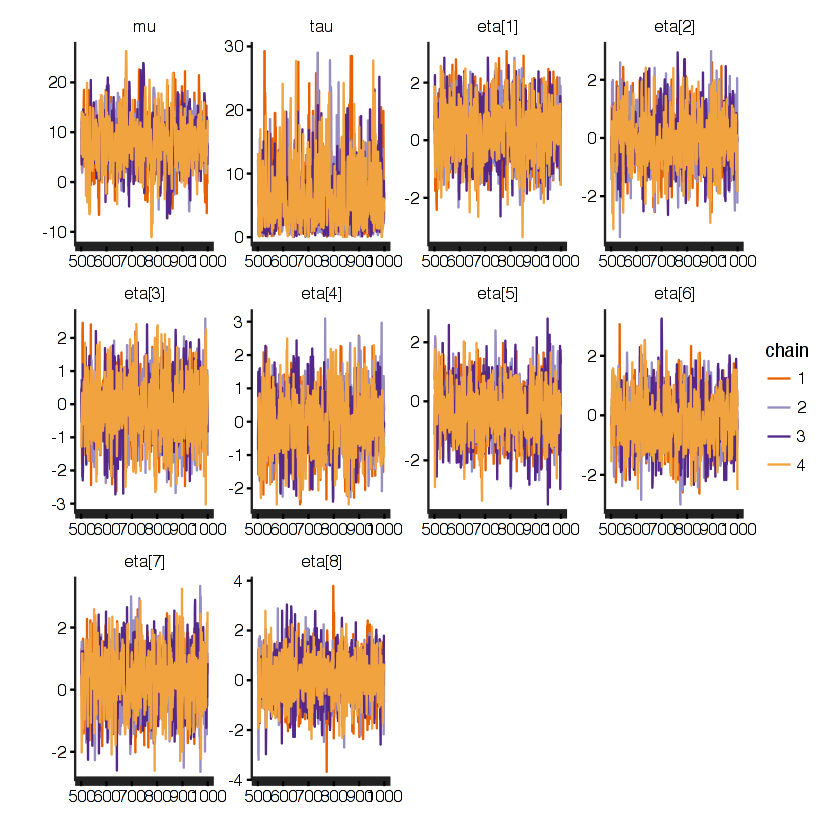

In [4]:
traceplot(fit )